# Import packages

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
import scipy.cluster.hierarchy as sch

from sklearn.decomposition import PCA

import descartes
import geopandas as gpd
from shapely.geometry import Point, Polygon

%matplotlib inline

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))

# Get Data From data.gouv.fr

https://www.data.gouv.fr/fr/datasets/indices-annuels-de-precipitations-et-nombre-de-jours-de-precipitations-issus-du-modele-aladin-climat/#_
https://www.data.gouv.fr/fr/datasets/indices-annuels-de-temperature-et-nombre-de-jours-de-temperature-issus-du-modele-aladin-climat/

In [3]:
precip = pd.read_csv(r'precip.txt', sep = ';')
temp = pd.read_csv(r'temp.txt', sep = ';')

# Data Preparation

In [4]:
#Drop empty columns
precip.drop(columns = {'Unnamed: 13', 'Contexte'}, inplace= True)
temp.drop(columns = {'Unnamed: 24', 'Contexte'}, inplace= True)

#Merge data
df = pd.merge(precip, temp,
             left_on= ['Point', 'Latitude', 'Longitude', 'Integration'],
             right_on= ['Point', 'Latitude', 'Longitude', 'Integration'],
             how= 'inner')

#Get dummies for the categorical column
df = pd.get_dummies(df, prefix= ['Integration'])

#Avoid the "dummy variable trap" : 
df.drop(columns= {'Integration_H3'}, inplace= True)

# Find optimal numbers of clusters

In [5]:
#Normalized data
X = df.values
sc_X = StandardScaler()
X = sc_X.fit_transform(X)

<Figure size 720x720 with 0 Axes>

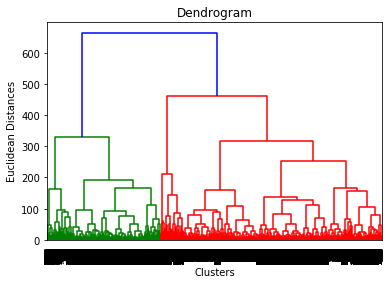

<Figure size 720x720 with 0 Axes>

In [6]:
# Warning, This cells is very long to compute !

#Plot dendrogram to find the optimal number K of clusters
dendrogram = sch.dendrogram(sch.linkage(X, method = 'ward'))
plt.title('Dendrogram')
plt.xlabel('Clusters')
plt.ylabel('Euclidean Distances')
plt.figure(figsize=(10,10))

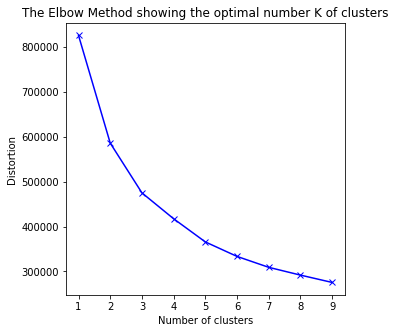

In [7]:
#Compute with the Elbow Method the optimal number K of clusters
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters = k)
    kmeanModel.fit(X)
    distortions.append(kmeanModel.inertia_)
    
plt.figure(figsize=(5,5))
plt.plot(K, distortions, 'bx-')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal number K of clusters')
plt.show()

Theses 2 graph show that the optimal number of clusters is 2 or 3.
This course is about data visualisation and the final graph will be easier to analysed with more than 3 clusters.

This number can be change is the next cell.

In [8]:
k_no_PCA = 4

# Compute PCA

Sources : https://towardsdatascience.com/an-approach-to-choosing-the-number-of-components-in-a-principal-component-analysis-pca-3b9f3d6e73fe

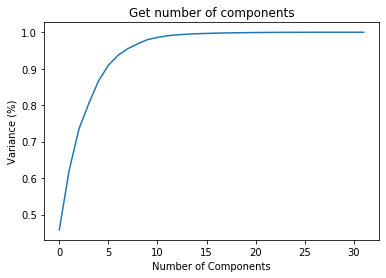

In [28]:
#Fitting the PCA algorithm with our Data
pca = PCA().fit(X)
#Plotting the Cumulative Summation of the Explained Variance
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') #for each component
plt.title('Get number of components')
plt.show()

With 10 columns, we keep around 97% of the total variance. 

In [10]:
n_columns = 10

In [11]:
# Applying PCA
from sklearn.decomposition import PCA
pca = PCA(n_components= n_columns, svd_solver= 'full')
X_changed = pca.fit_transform(X)

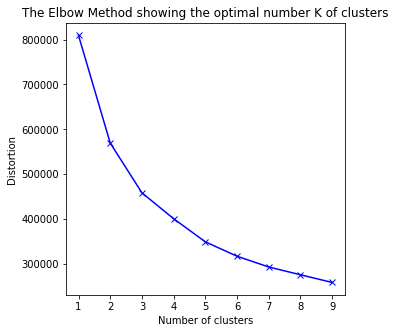

In [12]:
#Compute with the Elbow Method the optimal number K of clusters
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters = k)
    kmeanModel.fit(X_changed)
    distortions.append(kmeanModel.inertia_)
    
plt.figure(figsize=(5,5))
plt.plot(K, distortions, 'bx-')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal number K of clusters')
plt.show()

In [13]:
k_with_PCA = 4

# Agglomerative Clustering

In [14]:
hc_agglo_no_PCA = AgglomerativeClustering(n_clusters= k_no_PCA, affinity= 'euclidean', linkage= 'ward')
y_hc_agglo_no_PCA = hc_agglo_no_PCA.fit_predict(X)

cluster_df = df[['Point', 'Longitude', 'Latitude']].copy()
cluster_df.insert(3, "cluster_agglo_no_PCA", y_hc_agglo_no_PCA, True)

hc_agglo_with_PCA = AgglomerativeClustering(n_clusters= k_with_PCA, affinity= 'euclidean', linkage= 'ward')
y_hc_agglo_with_PCA = hc_agglo_with_PCA.fit_predict(X_changed)

cluster_df.insert(4, "cluster_agglo_with_PCA", y_hc_agglo_with_PCA, True)

# KMeans Clustering

In [15]:
hc_kmeans_no_PCA = KMeans(n_clusters= k_no_PCA, init='k-means++', max_iter=300, n_init=10, random_state=0)
y_hc_kmeans_no_PCA = hc_kmeans_no_PCA.fit_predict(X)

cluster_df.insert(5, "cluster_kmeans_no_PCA", y_hc_kmeans_no_PCA, True)

hc_kmeans_with_PCA = KMeans(n_clusters= k_with_PCA, init='k-means++', max_iter=300, n_init=10, random_state=0)
y_hc_kmeans_with_PCA = hc_kmeans_with_PCA.fit_predict(X_changed)

cluster_df.insert(6, "cluster_kmeans_with_PCA", y_hc_kmeans_with_PCA, True)

# Get GeoPandas DataFrame with Point

In [16]:
geometry = [Point(xy) for xy in zip(df['Longitude'], df['Latitude'])]
crs = {'init': 'epsg:4326'}
geo_df = gpd.GeoDataFrame(cluster_df, crs = crs, geometry= geometry)
geo_df.head()

,Point,Longitude,Latitude,cluster_agglo_no_PCA,cluster_agglo_with_PCA,cluster_kmeans_no_PCA,cluster_kmeans_with_PCA,geometry
0,282,9.1577,41.4087,3,0,2,0,POINT (9.15770 41.40870)
1,423,8.9759,41.4925,3,0,2,0,POINT (8.97590 41.49250)
2,424,9.0710,41.4864,3,0,2,0,POINT (9.07100 41.48640)
3,425,9.1660,41.4802,3,0,2,0,POINT (9.16600 41.48020)
4,426,9.2610,41.4739,3,0,2,0,POINT (9.26100 41.47390)


# Plot Data & Comparing Clustering Method

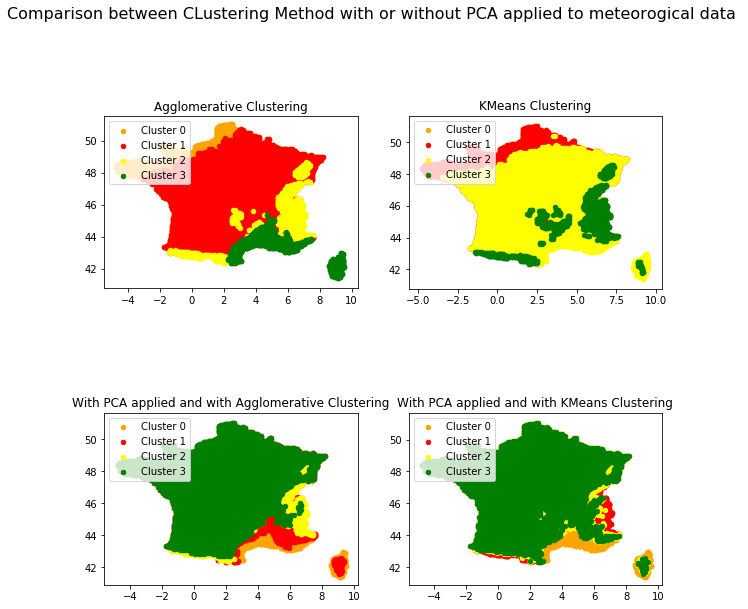

In [21]:
color = ['orange', 'red', 'yellow', 'green']

fig, axs = plt.subplots(2, 2, figsize=(10, 10))
axs[0,0].set_title('Agglomerative Clustering')
axs[0,1].set_title('KMeans Clustering')
axs[1,0].set_title('With PCA applied and with Agglomerative Clustering')
axs[1,1].set_title('With PCA applied and with KMeans Clustering')
fig.suptitle('Comparison between CLustering Method with or without PCA applied to meteorogical data ', fontsize=16)  

#No PCA
for i in range(k_no_PCA): 
    geo_df[geo_df['cluster_agglo_no_PCA'] == i].plot(ax= axs[0,0], markersize= 20, color= color[i], marker= 'o', label= 'Cluster '+ str(i))
    axs[0,0].legend(loc="upper left")
for i in range(k_no_PCA): 
    geo_df[geo_df['cluster_kmeans_no_PCA'] == i].plot(ax= axs[0,1], markersize= 20, color= color[i], marker= 'o', label= 'Cluster '+ str(i))
    axs[0,1].legend(loc="upper left")

#With PCA
for i in range(k_with_PCA): 
    geo_df[geo_df['cluster_agglo_with_PCA'] == i].plot(ax= axs[1,0], markersize= 20, color= color[i], marker= 'o', label= 'Cluster '+ str(i))
    axs[1,0].legend(loc="upper left")
for i in range(k_with_PCA): 
    geo_df[geo_df['cluster_kmeans_with_PCA'] == i].plot(ax= axs[1,1], markersize= 20, color= color[i], marker= 'o', label= 'Cluster '+ str(i))
    axs[1,1].legend(loc="upper left")
plt.show()

In [26]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

fig = px.scatter_mapbox(geo_df, lat= 'Latitude', lon= 'Longitude', hover_name= 'cluster_agglo_no_PCA', hover_data= ['cluster_agglo_no_PCA','Point', 'Latitude', 'Longitude'],
                       color= 'cluster_agglo_no_PCA', zoom= 10, height= 100)
fig.layout = go.Layout(mapbox_style= 'open-street-map', margin= {'l': 0, 'r': 0, 't': 0, 'b': 0})
fig.show()

fig = px.scatter_mapbox(geo_df, lat= 'Latitude', lon= 'Longitude', hover_name= 'cluster_kmeans_no_PCA', hover_data= ['cluster_kmeans_no_PCA','Point', 'Latitude', 'Longitude'],
                       color= 'cluster_kmeans_no_PCA', zoom= 10, height= 100)
fig.layout = go.Layout(mapbox_style= 'open-street-map', margin= {'l': 0, 'r': 0, 't': 0, 'b': 0})
fig.show()

fig = px.scatter_mapbox(geo_df, lat= 'Latitude', lon= 'Longitude', hover_name= 'cluster_agglo_with_PCA', hover_data= ['cluster_agglo_with_PCA','Point', 'Latitude', 'Longitude'],
                       color= 'cluster_agglo_with_PCA', zoom= 10, height= 100)
fig.layout = go.Layout(mapbox_style= 'open-street-map', margin= {'l': 0, 'r': 0, 't': 0, 'b': 0})
fig.show()

fig = px.scatter_mapbox(geo_df, lat= 'Latitude', lon= 'Longitude', hover_name= 'cluster_kmeans_with_PCA', hover_data= ['cluster_kmeans_with_PCA','Point', 'Latitude', 'Longitude'],
                       color= 'cluster_kmeans_with_PCA', zoom= 10, height= 100)
fig.layout = go.Layout(mapbox_style= 'open-street-map', margin= {'l': 0, 'r': 0, 't': 0, 'b': 0})
fig.show()